<a href="https://colab.research.google.com/github/Eduzc07/machinelearning/blob/master/9_Entertainment/ReinforcementLearning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reinforcement Learning

Install all the dependencies to render and display gym.

In [1]:
!apt-get install x11-utils > /dev/null 2>&1
!apt-get install -y xvfb python-opengl > /dev/null 2>&1
!pip install gym pyvirtualdisplay > /dev/null 2>&1
!pip install pyglet==v1.3.2

Active virtual display.

In [2]:
from pyvirtualdisplay import Display

display = Display(visible=0, size=(1400, 900))
display.start()

<Display cmd_param=['Xvfb', '-br', '-nolisten', 'tcp', '-screen', '0', '1400x900x24', ':1001'] cmd=['Xvfb', '-br', '-nolisten', 'tcp', '-screen', '0', '1400x900x24', ':1001'] oserror=None return_code=None stdout="None" stderr="None" timeout_happened=False>

Import all the libraries.

In [3]:
# -*- coding: utf-8 -*-
import random
import numpy as np
import gym
from collections import deque
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.optimizers import Adam

import matplotlib.pyplot as plt
import matplotlib.animation
from matplotlib.ticker import MaxNLocator
from IPython.display import HTML
from IPython import display as ipythondisplay
%matplotlib inline

# This code creates a virtual display to draw game images on. 
# If you are running locally, just ignore it
import os
if type(os.environ.get("DISPLAY")) is not str or len(os.environ.get("DISPLAY"))==0:
    !bash ../xvfb start
    %env DISPLAY=:1

Using TensorFlow backend.


Create a function to plot Scores and Rewards.

In [0]:
def displayScores(trials, scores, all_scores, title = 'Test Random CartPole-v1'):
    # plot the scores
    fig = plt.figure()
    fig.set_size_inches(14, 14)
    #fig.patch.set_facecolor('xkcd:charcoal')
    title_obj = fig.suptitle(title, fontsize=25)
    plt.setp(title_obj, color='white')         #set the color of title to red
    fig.tight_layout()

    # Plot 1
    ax = fig.add_subplot(211)
    ax.tick_params(axis='x', colors='white')
    ax.tick_params(axis='y', colors='white')
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    
    ep = np.arange(1, len(trials)+1)
    plt.plot(ep, trials)
    plt.plot([1, len(trials)], [100, 100], color='green', marker='o', linestyle='dashed', linewidth=2, markersize=5)
    ax.legend(['Trials per Episode', 'over 100 consecutive'], fontsize=14)
    #ax.set_title('Episodes vs Trials', fontsize=18, color='white')
    ax.set_ylabel('Trials', fontsize=20, color='white')
    #ax.set_xlabel('Episode #', fontsize=20, color='white')
    ax.grid(linestyle='--', linewidth=1)

    # Plot 2
    ax = fig.add_subplot(212)
    ax.tick_params(axis='x', colors='white')
    ax.tick_params(axis='y', colors='white')
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.plot(ep, scores, color = 'red', linewidth=2)
    plt.plot(ep, all_scores, color = 'orange', linestyle='dashed')
    plt.plot([1, len(scores)], [195, 195], color='green', marker='o', linestyle='dashed', linewidth=2, markersize=5)
    #plt.plot([1, len(scores)], [np.mean(rewards), np.mean(rewards)], color='orange', marker='o', linestyle='dashed', linewidth=2, markersize=5)
    ax.legend(['Average Score', 'All scores', 'greater than 195.0'], fontsize=14)
    #ax.set_title('Episodes vs Scores', fontsize=18, color='white')
    ax.set_ylabel('Scores', fontsize=20, color='white')
    ax.set_xlabel('Episode #', fontsize=20, color='white')
    ax.grid(linestyle='--', linewidth=1)

    plt.show()

#### Test some Random values

In [6]:
env = gym.make('CartPole-v1')
n_episodes = 5
max_episode_len = 500
frames = []
times = []
n_avg_scores = 100
scores = deque(maxlen=n_avg_scores)
avg_scores = []
all_scores = []

for i in range(n_episodes):
    obs = env.reset()
    done = False
    Rewards = 0
    time = 0
    #while not done and time < max_episode_len:
    while time < max_episode_len:
        if time%2==0:
          frames.append(env.render(mode = 'rgb_array'))

        action = env.action_space.sample()
        obs, reward, done, _ = env.step(action)
        reward = reward if not done else - 10
        Rewards += reward
        time += 1

        # Position X-axis
        posX = obs[0]
        #It will be broken only when it is out the boundary.
        if (posX < -3.0 or posX > 3.0):
          break

    times.append(time)
    scores.append(Rewards)
    all_scores.append(Rewards)
    avg_score = np.mean(scores)
    avg_scores.append(avg_score)
    print("episode: {}/{}, Average Score: {:.0f}, Trials: {}"
                .format(i + 1, n_episodes, avg_score, time))
    
env.close()
print('Finished.')

/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: You are calling 'step()' even though this environment has already returned done = True. You should always call 'reset()' once you receive 'done = True' -- any further steps are undefined behavior.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


episode: 1/5, Average Score: -1409, Trials: 164
episode: 2/5, Average Score: -1770, Trials: 234
episode: 3/5, Average Score: -1481, Trials: 108
episode: 4/5, Average Score: -1262, Trials: 87
episode: 5/5, Average Score: -1215, Trials: 150
Finished.


#### Display results

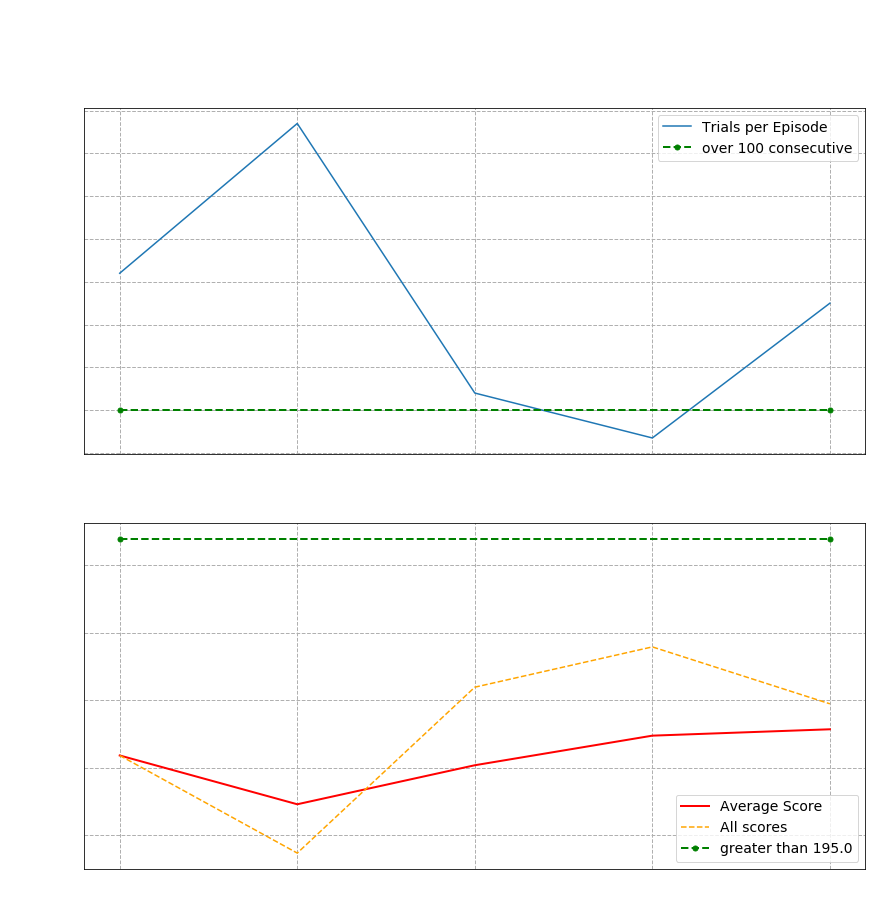

In [7]:
displayScores(times, avg_scores, all_scores, 'Test Random CartPole-v1')

#### Create Animation

<Figure size 432x288 with 0 Axes>

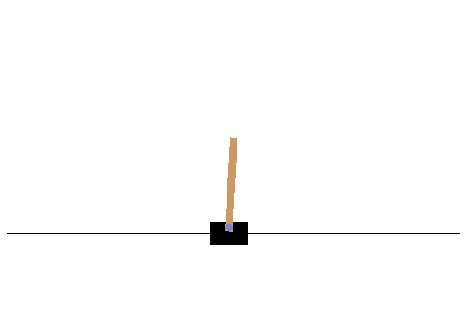

In [8]:
fig = plt.figure()
fig.patch.set_facecolor('xkcd:charcoal')

plt.figure(figsize=(frames[0].shape[1] / 72.0, frames[0].shape[0] / 72.0), dpi = 72)
patch = plt.imshow(frames[0])
plt.axis('off')
animate = lambda i: patch.set_data(frames[i])
ani = matplotlib.animation.FuncAnimation(plt.gcf(),
                                         animate,
                                         frames = len(frames),
                                         interval = 30)
HTML(ani.to_jshtml())

## Deep Q-Learning with Keras and Gym

Creation of a Deep Q-Learning Agent based on [keon](https://github.com/keon/deep-q-learning).

In [0]:
class DQNAgent:
    def __init__(self, state_size, action_size):
        self.state_size = state_size
        self.action_size = action_size
        self.memory = deque(maxlen=2000)
        self.gamma = 0.95    # discount rate
        self.epsilon = 1.0   # exploration rate
        self.epsilon_min = 0.01
        self.epsilon_decay = 0.995
        self.learning_rate = 0.001
        self.model = self._build_model()
        # self.target_model = self._build_model()
        # self.update_target_model()

    def _build_model(self):
        # Neural Net for Deep-Q learning Model
        model = Sequential()
        model.add(Dense(24, input_dim=self.state_size, activation='relu'))
        model.add(Dense(24, activation='relu'))
        model.add(Dense(self.action_size, activation='linear'))
        model.compile(loss='mse', optimizer=Adam(lr=self.learning_rate))
        model.summary()
        return model

    # def update_target_model(self):
    #     # copy weights from model to target_model
    #     self.target_model.set_weights(self.model.get_weights())

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_size)

        # Predict the reward value based on the given state
        act_values = self.model.predict(state)
        # Pick the action based on the predicted reward
        return np.argmax(act_values[0])  # returns action

    def replay(self, batch_size):
        minibatch = random.sample(self.memory, batch_size)
        for state, action, reward, next_state, done in minibatch:
            target = reward
            if not done:
              t = self.model.predict(next_state)[0]
              target = (reward + self.gamma * np.amax(t))

            target_f = self.model.predict(state)
            target_f[0][action] = target

            # Train the Neural Net with the state and target_f
            self.model.fit(state, target_f, epochs=1, verbose=0)

        # Decrease randomness
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

Initialize all the variables and create the environment.

In [6]:
env = gym.make('CartPole-v1')
state_size = env.observation_space.shape[0]
action_size = env.action_space.n
print("Observation space:", env.observation_space)
print("Action space:", env.action_space)
agent = DQNAgent(state_size, action_size)
done = False
batch_size = 32

Observation space: Box(4,)
Action space: Discrete(2)




Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 24)                120       
_________________________________________________________________
dense_2 (Dense)              (None, 24)                600       
_________________________________________________________________
dense_3 (Dense)              (None, 2)                 50        
Total params: 770
Trainable params: 770
Non-trainable params: 0
_________________________________________________________________


Episode Termination:
- Pole Angle is more than 12 degrees
- Cart Position is more than 2.4 (center of the cart reaches the edge of the display)
- Episode length is greater than 200
- Solved Requirements
- Considered solved when the average reward is greater than or equal to 195.0 over 100 consecutive trials.

## Training

Here the agent will train 'n-EPISODES' untill it reachs the goal, when the average reward is **greater than or equal to 195.0 over 100 consecutive trials**.

In [0]:
EPISODES = 50
max_episode_len = 500
frames = []
times = []
n_avg_scores = 100
scores = deque(maxlen = n_avg_scores)
avg_scores = []
all_scores = []

In [34]:
for e in range(EPISODES + 1):
  state = env.reset()
  state = np.reshape(state, [1, state_size])
  total_rewards = 0

  for time in range(max_episode_len):
      if time%10==0:
        frames.append(env.render(mode = 'rgb_array'))

      # Decide action
      action = agent.act(state)

      # Advance the game to the next frame based on the action.
      # Reward is 1 for every frame the pole survived
      next_state, reward, done, _ = env.step(action)
      reward = reward if not done else -10
      total_rewards += reward
      next_state = np.reshape(next_state, [1, state_size])
      
      # Remember the previous state, action, reward, and done
      agent.remember(state, action, reward, next_state, done)

      # make next_state the new current state for the next frame.
      state = next_state

      if done:
        #agent.update_target_model()
        times.append(time)
        scores.append(total_rewards)
        all_scores.append(total_rewards)
        avg_score = np.mean(scores)
        avg_scores.append(avg_score)

        if e%5 == 0:
            print("episode: {}/{}, Average Score: {:.0f}, Trials: {}, e: {:.4}"
                  .format(e, EPISODES, avg_score, time, agent.epsilon))
        break

      # train the agent with the experience of the episode
      if len(agent.memory) > batch_size:
        agent.replay(batch_size)

#env.close()
print('Finished.')

episode: 0/50, Average Score: 53, Trials: 256, e: 0.009986
episode: 5/50, Average Score: 59, Trials: 97, e: 0.009986
episode: 10/50, Average Score: 60, Trials: 242, e: 0.009986
episode: 15/50, Average Score: 66, Trials: 9, e: 0.009986
episode: 20/50, Average Score: 60, Trials: 35, e: 0.009986
episode: 25/50, Average Score: 60, Trials: 267, e: 0.009986
episode: 30/50, Average Score: 75, Trials: 244, e: 0.009986
episode: 35/50, Average Score: 86, Trials: 277, e: 0.009986
episode: 40/50, Average Score: 100, Trials: 184, e: 0.009986
episode: 45/50, Average Score: 103, Trials: 109, e: 0.009986
episode: 50/50, Average Score: 113, Trials: 227, e: 0.009986
Finished.


#### Display results after Training

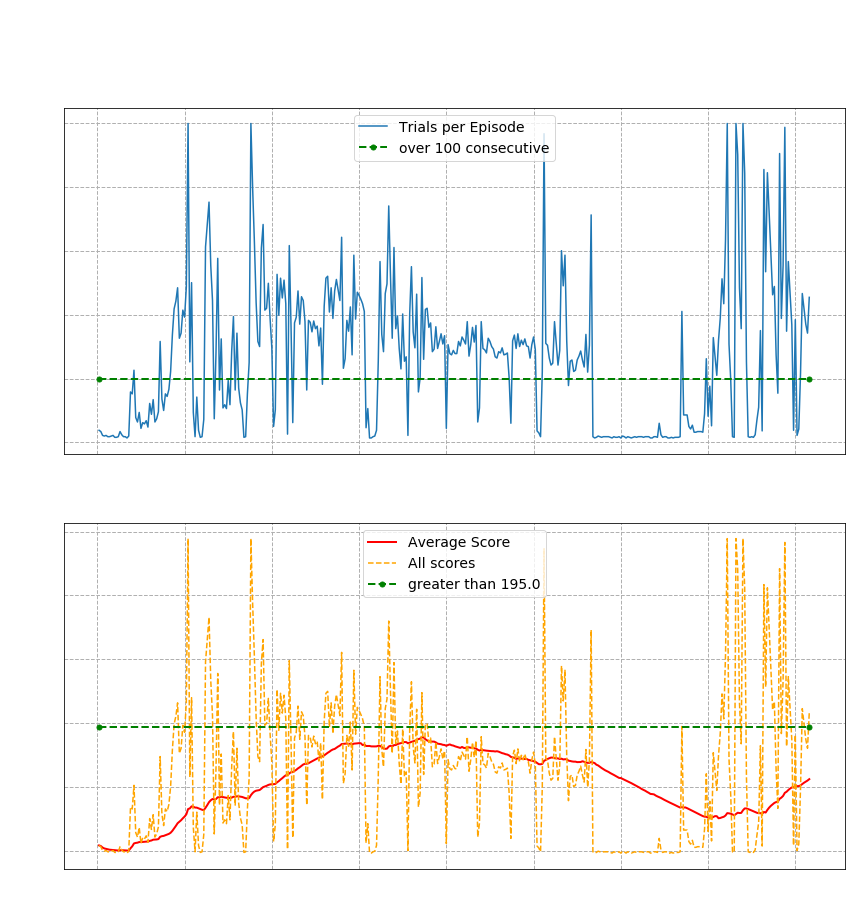

In [35]:
displayScores(times, avg_scores, all_scores, 'Training CartPole-v1')

#### Create Animation of training

<Figure size 432x288 with 0 Axes>

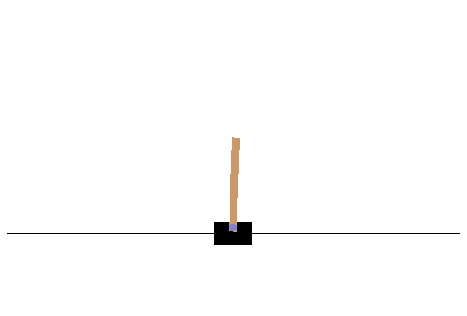

In [36]:
fig = plt.figure()
fig.patch.set_facecolor('xkcd:charcoal')

plt.figure(figsize=(frames[0].shape[1] / 72.0, frames[0].shape[0] / 72.0), dpi = 72)
patch = plt.imshow(frames[0])
plt.axis('off')
animate = lambda i: patch.set_data(frames[i])
ani = matplotlib.animation.FuncAnimation(plt.gcf(),
                                         animate,
                                         frames=len(frames),
                                         interval = 30)
HTML(ani.to_jshtml())

## Validation of Results

Here the Agent wil be used to validate the result.

In [37]:
n_episodes = 5
max_episode_len = 2000

frames_val = []
scores_val = deque(maxlen=n_avg_scores)
# times = []
# n_avg_scores = 100
# scores = deque(maxlen=n_avg_scores)
# avg_scores = []
# all_scores = []

for e in range(n_episodes):
  state = env.reset()
  state = np.reshape(state, [1, state_size])
  total_rewards = 0

  for time in range(max_episode_len):
    if time%2==0:
      frames_val.append(env.render(mode = 'rgb_array'))

    # Decide action
    action = agent.act(state)

    # Advance the game to the next frame based on the action.
    # Reward is 1 for every frame the pole survived
    next_state, reward, done, _ = env.step(action)
    #reward = reward if not done else -10
    total_rewards += reward

    # make next_state the new current state for the next frame.
    #state = next_state
    state = np.reshape(next_state, [1, state_size])

    # Position X-axis
    posX = next_state[0]
    #It will be broken only when it is out the boundary.
    if (posX < -3.0 or posX > 3.0):
      break
  
  # times.append(time)
  scores_val.append(total_rewards)
  # all_scores.append(total_rewards)
  avg_score = np.mean(scores_val)
  # avg_scores.append(avg_score)

  isOk = ""
  if avg_score >= 195 and time > 100:
    isOk = ", --> Ok"

  print("episode: {}/{}, Average Score: {:.0f}, Trials: {}, e: {:.4}{}"
            .format(e + 1, n_episodes, avg_score, time, agent.epsilon, isOk))

env.close()
print('Finished.')

/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: You are calling 'step()' even though this environment has already returned done = True. You should always call 'reset()' once you receive 'done = True' -- any further steps are undefined behavior.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


episode: 1/5, Average Score: 79, Trials: 134, e: 0.009986
episode: 2/5, Average Score: 170, Trials: 340, e: 0.009986
episode: 3/5, Average Score: 187, Trials: 306, e: 0.009986
episode: 4/5, Average Score: 159, Trials: 128, e: 0.009986
episode: 5/5, Average Score: 177, Trials: 349, e: 0.009986
Finished.


#### Display results of Validation

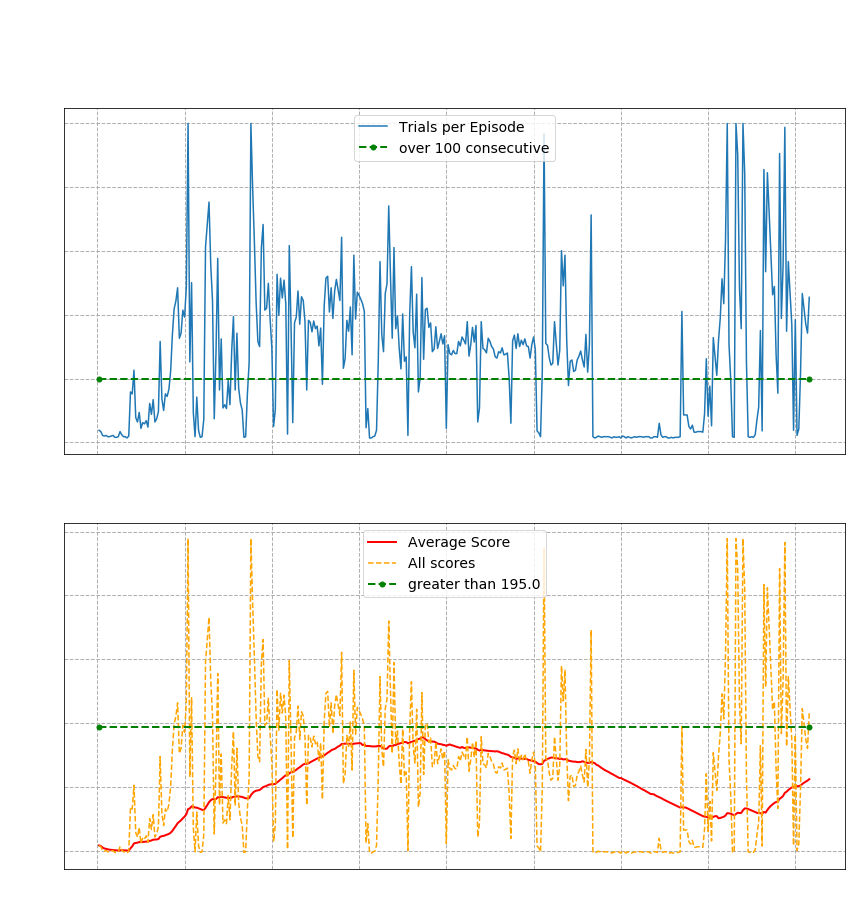

In [38]:
displayScores(times, avg_scores, all_scores, 'Validation CartPole-v1')

#### Create Animation of Validation

<Figure size 432x288 with 0 Axes>

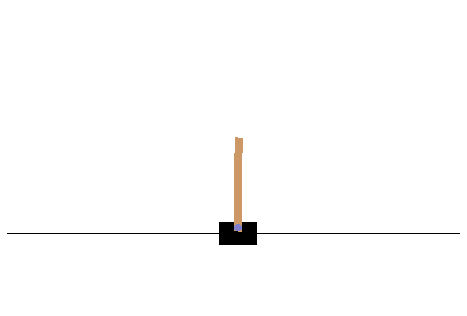

In [39]:
fig = plt.figure()
fig.patch.set_facecolor('xkcd:charcoal')

plt.figure(figsize=(frames_val[0].shape[1] / 72.0, frames_val[0].shape[0] / 72.0), dpi = 72)
patch = plt.imshow(frames_val[0])
plt.axis('off')
animate = lambda i: patch.set_data(frames_val[i])
ani = matplotlib.animation.FuncAnimation(plt.gcf(),
                                         animate,
                                         frames = len(frames_val),
                                         interval = 30)
HTML(ani.to_jshtml())

## Sources
- [Reinforcement Learning on google colab](https://medium.com/@kaleajit27/reinforcement-learning-on-google-colab-9cb2e1ef51e)
- [Deep Q-Learning with Keras and Gym](https://keon.io/deep-q-learning/)

- [Rendering OpenAi Gym in Colaboratory](https://colab.research.google.com/drive/1flu31ulJlgiRL1dnN2ir8wGh9p7Zij2t)

- [ChainerRL Quickstart Guide](https://colab.research.google.com/drive/1XQaqLeUpn299ZdDDJ7CtGtJkZ0A-Tgii#scrollTo=Mg8j6iCiwMVg)

- [Reinforcement Learning Tutorial with Open AI Gym](https://towardsdatascience.com/reinforcement-learning-tutorial-with-open-ai-gym-9b11f4e3c204)

- [Cartpole - Introduction to Reinforcement Learning (DQN - Deep Q-Learning)](https://towardsdatascience.com/cartpole-introduction-to-reinforcement-learning-ed0eb5b58288)

- [Teaching A Deep Q Neural Network How To Balance](https://github.com/iRyanBell/dqn_cartpole/blob/master/cartpole.ipynb)